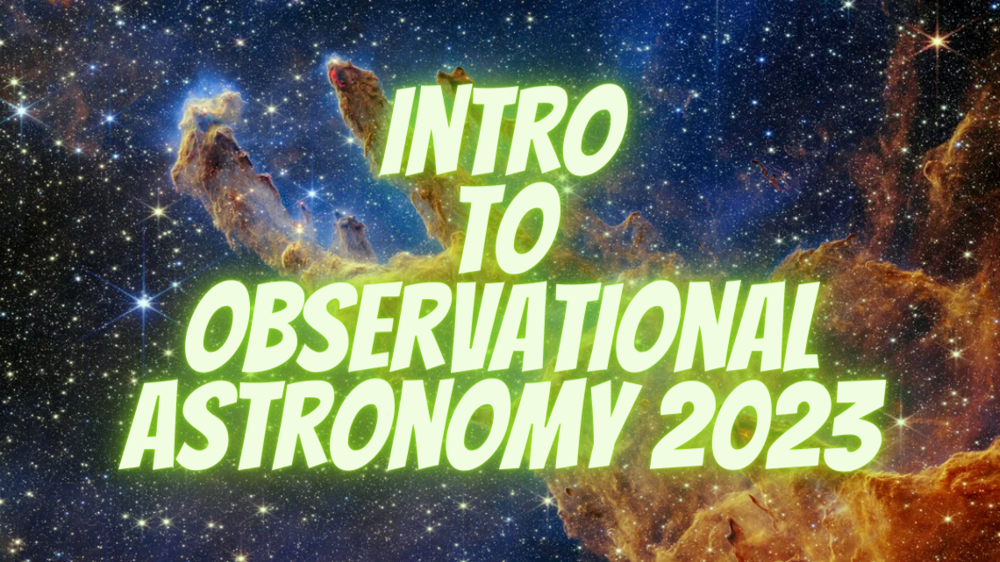

# Why am I doing this?
IISER-K does not have any Astronomy club which inhibits Astronomy discussion among peers, so this I am making an attempt to spark discussion among peers about astronomy through this interactive session.

# Why you should care about Astronomy?
It's fun and exciting!

# Am I eligible to conduct the workshop?
I don't know, but as no one is doing it I have decided to do it. I'll definitely try to make it worth your time :)


# What will you learn?
*   How a CCD (Charged Coupled Device) is used to take images.
*   How to download data from the archives.
*   How to read and understand the data.
*   Learn about **SDSS** (Sloan Digital Sky Survey) and it's filters
*   Make a composite image of **M51** (Whirlpool Galaxy) using SDSS images.
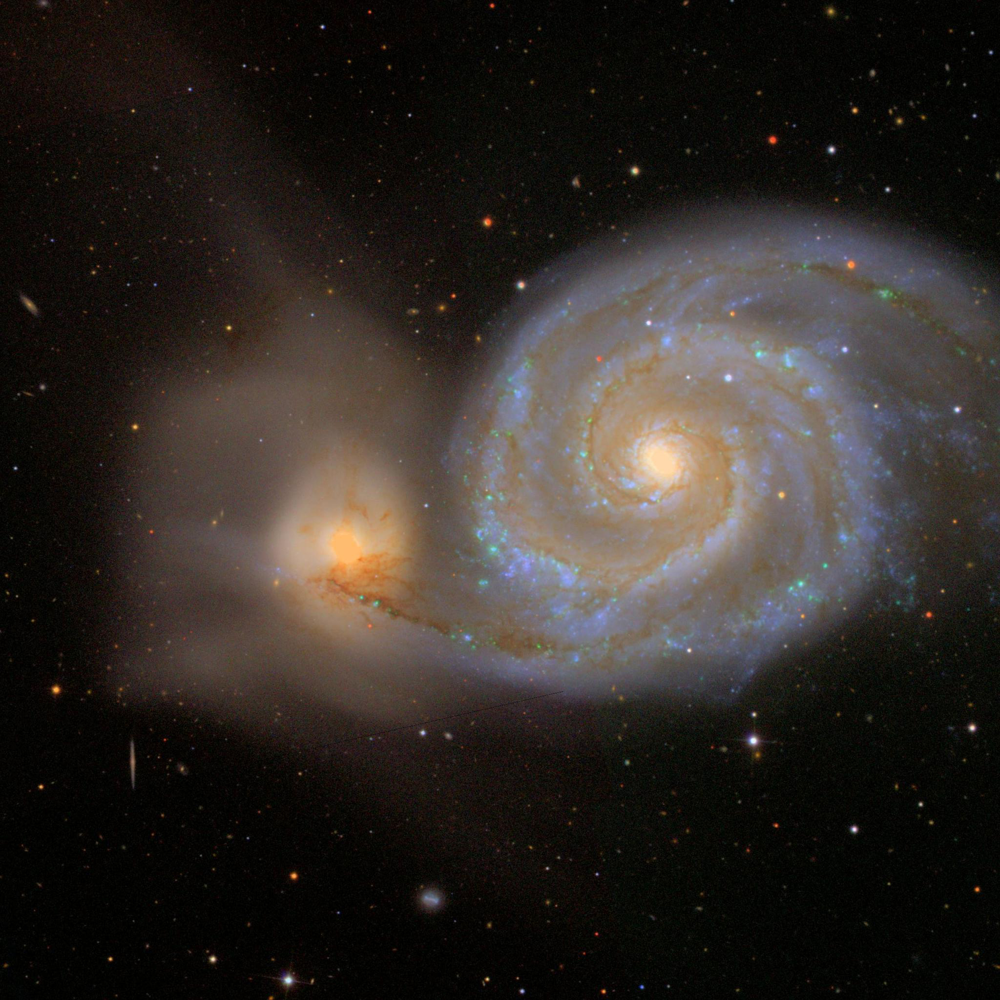
(Credits: SDSS)


# What software you will need?
Everything will be done in Jupyter-Notebooks, we will also use conda to make an isolated environment for the python packages. Therefore make sure you have a working installation of [**Jupyter-Notebook**](https://jupyter.org/install) and [**Conda**](https://docs.conda.io/projects/conda/en/latest/user-guide/install/linux.html).

## Downloading the files
I will start a local server HTTP server on my local device from which you can download the folder of this workshop.

`user: Astro_workshop`

`password: M51`

Download and the unzip the files.

## Setting up the environment
1) Install the conda environment: `conda env create -f intro_astro_workshop.yml` (make sure you do this in the directory containing the .yml file)
2) Activate the conda environment: `conda activate intro_astro_workshop`
3) Add the environment kernel to the jupyter kernel list: `python -m ipykernel install --user --name intro_astro_workshop --display-name "Python (astro_workshop)"`

# Sloan Digital Sky Survey (SDSS)
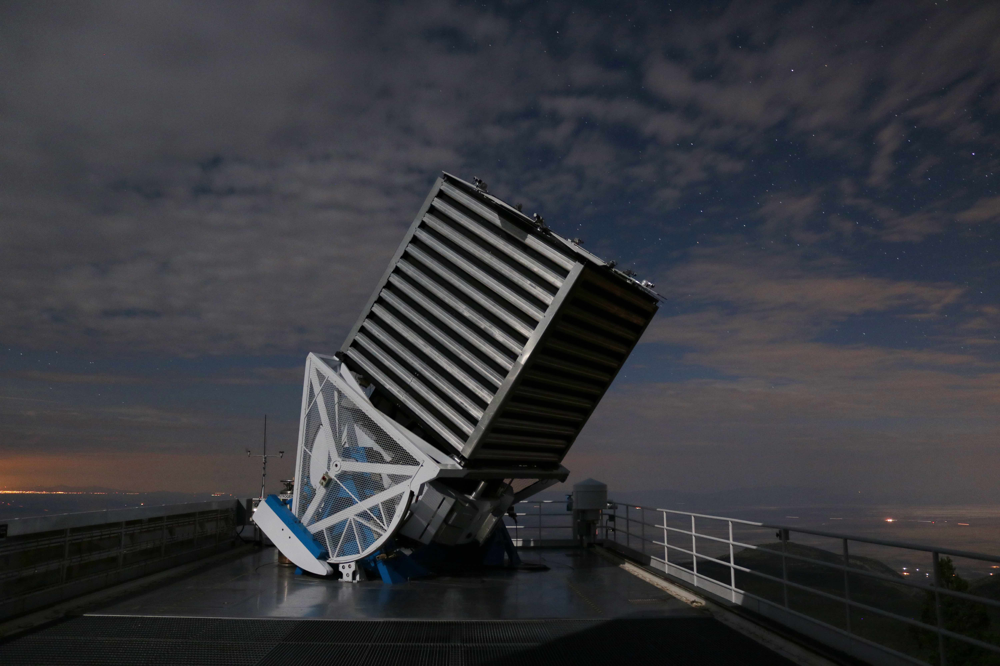
(Credits: SDSS)

It's a 2.5m wide-angle optical survey telescope at Apache Point Observatory in New Mexico, United States.

## What is a CCD?
CCD (Charged Coupled Device) is a highly sensitive photon detector used for imaging in telescopes. It has a grid of pixels on which when photon falls it ejects the electron present in the metal and this creates a voltage difference which depends on the number of electrons eject which depends on the number of the photons falling on that pixel thus measuring the voltage generated in each pixel gives us the measure of the "light" or count of the photons, these are usually given in digital numbers (or DNs) which is the number of photons falling on a pixel.
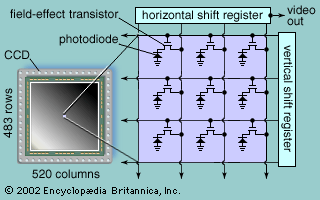

(Credits: https://kids.britannica.com/kids/assembly/view/60167)

![image.png](CCD.gif)
(Credits: http://www.dchome.net/forum.php?mod=viewthread&tid=1391031&extra=page%3D1&page=2)

## What are filters?
Filters are exactly what they mean they filter out light which is not required. In astronomy when imaging we take what's called a monochromatic image, meaning an image which has only only wavelength of light, this is achieved using a band-pass filter which allows only a small range of wavelength of light to pass and blocks other wavelength. These monochromatic images are then overlapped to give us what's called a false color images (space images which we see on the internet).

Response function of human rod cells
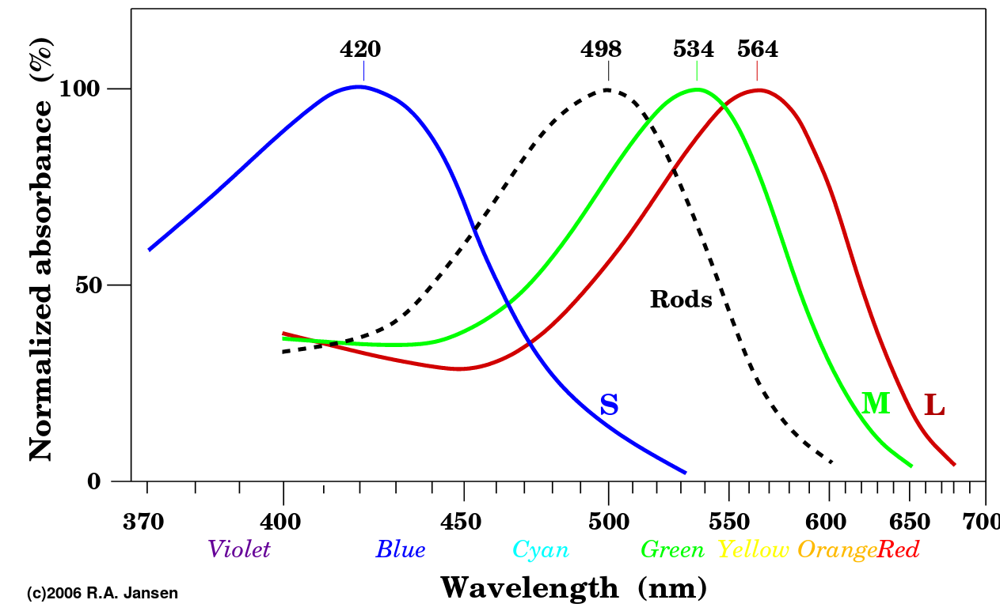

The images which we observe is the convolution of the filters response function and the light coming from the object.

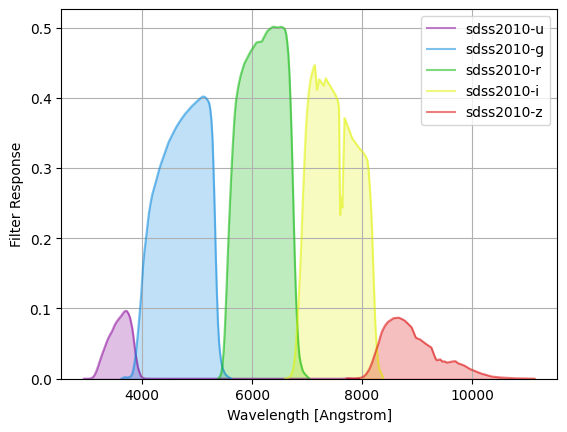

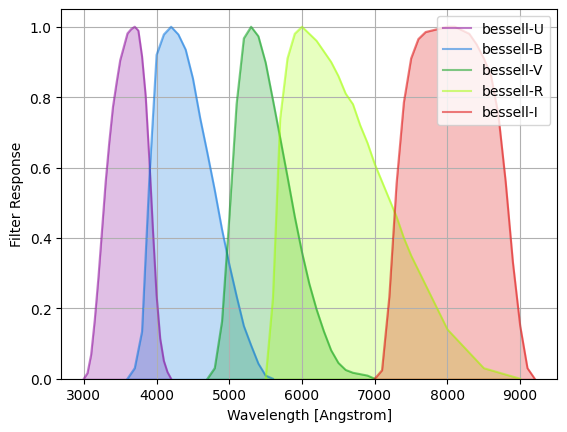

In [1]:
from speclite import filters as flt

sdss=flt.load_filters("sdss2010-*")
john=flt.load_filters("bessell-*")
flt.plot_filters(sdss)
flt.plot_filters(john)

## Downloading the Data
We will use [SDSS DR12](https://dr12.sdss.org/fields) to download the data. Due internet issues I have already downloaded th e data which is in the ./Data folder.
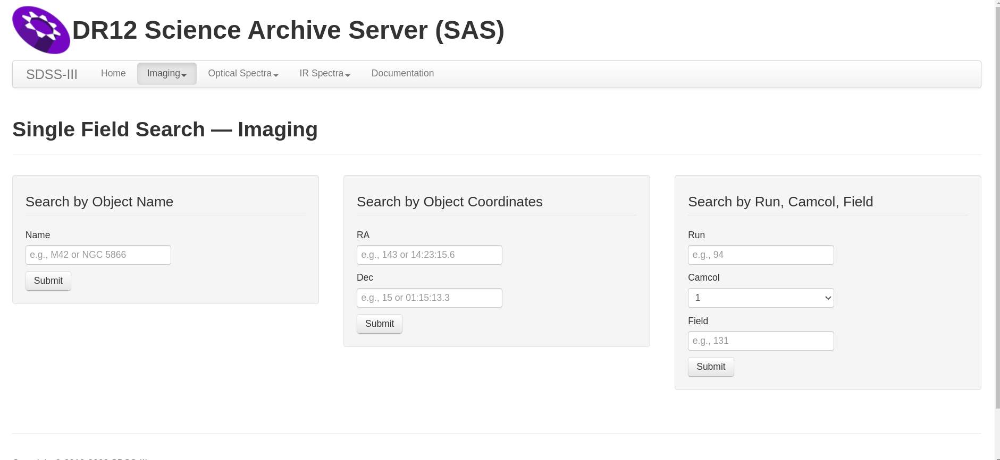
## FITS handling
Flexible Image Transport System (FITS) is an image format which is used in astronomy to store the data. Data stored in this format is usually uncompressed which is not the case in .png, .jpg formats. This format has lots of useful meta information apart from the data itself which is indispensable when doing research.

In [2]:
from astropy.io import fits
import matplotlib.pyplot as plt
import numpy as np

u_band=fits.open("Data/frame-u-003699-6-0100.fits.bz2")
g_band=fits.open("Data/frame-g-003699-6-0100.fits.bz2")
r_band=fits.open("Data/frame-r-003699-6-0100.fits.bz2")

In [3]:
print(u_band.info())

Filename: Data/frame-u-003699-6-0100.fits.bz2
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      96   (2048, 1489)   float32   
  1                1 ImageHDU         6   (2048,)   float32   
  2                1 BinTableHDU     27   1R x 3C   [49152E, 2048E, 1489E]   
  3                1 BinTableHDU     79   1R x 31C   [J, 3A, J, A, D, D, 2J, J, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, E, E]   
None


In [4]:
u_band[0].header

SIMPLE  =                    T /                                                
BITPIX  =                  -32 / 32 bit floating point                          
NAXIS   =                    2                                                  
NAXIS1  =                 2048                                                  
NAXIS2  =                 1489                                                  
EXTEND  =                    T /Extensions may be present                       
BZERO   =              0.00000 /Set by MRD_SCALE                                
BSCALE  =              1.00000 /Set by MRD_SCALE                                
TAI     =        4553664165.33 / 1st row - Number of seconds since Nov 17 1858  
RA      =            202.18225 / 1st row - Right ascension of telescope boresigh
DEC     =            46.194868 / 1st row - Declination of telescope boresight (d
SPA     =             102.580  / 1st row - Camera col position angle wrt north (
IPA     =             331.45

In [5]:
g_band[0].header

SIMPLE  =                    T /                                                
BITPIX  =                  -32 / 32 bit floating point                          
NAXIS   =                    2                                                  
NAXIS1  =                 2048                                                  
NAXIS2  =                 1489                                                  
EXTEND  =                    T /Extensions may be present                       
BZERO   =              0.00000 /Set by MRD_SCALE                                
BSCALE  =              1.00000 /Set by MRD_SCALE                                
TAI     =        4553664308.61 / 1st row - Number of seconds since Nov 17 1858  
RA      =            203.02452 / 1st row - Right ascension of telescope boresigh
DEC     =            46.061354 / 1st row - Declination of telescope boresight (d
SPA     =             103.187  / 1st row - Camera col position angle wrt north (
IPA     =             331.85

In [6]:
r_band[0].header

SIMPLE  =                    T /                                                
BITPIX  =                  -32 / 32 bit floating point                          
NAXIS   =                    2                                                  
NAXIS1  =                 2048                                                  
NAXIS2  =                 1489                                                  
EXTEND  =                    T /Extensions may be present                       
BZERO   =              0.00000 /Set by MRD_SCALE                                
BSCALE  =              1.00000 /Set by MRD_SCALE                                
TAI     =        4553664022.06 / 1st row - Number of seconds since Nov 17 1858  
RA      =            201.33610 / 1st row - Right ascension of telescope boresigh
DEC     =            46.322159 / 1st row - Declination of telescope boresight (d
SPA     =             101.969  / 1st row - Camera col position angle wrt north (
IPA     =             331.07

Go through [this page](https://data.sdss.org/datamodel/files/BOSS_PHOTOOBJ/frames/RERUN/RUN/CAMCOL/frame.html) for detailed information about all the header parameters.

In [7]:
u_band[1].header

XTENSION= 'IMAGE   '           /Image Extension created by MWRFITS v1.11        
BITPIX  =                  -32 /                                                
NAXIS   =                    1 /                                                
NAXIS1  =                 2048 /                                                
PCOUNT  =                    0 /                                                
GCOUNT  =                    1 /                                                

In [8]:
u_band[0].data

array([[-0.04327393, -0.00747681,  0.04022217, ...,  0.03912354,
        -0.05535889, -0.03173828],
       [ 0.00444794,  0.04022217,  0.00444794, ...,  0.0037117 ,
        -0.01989746, -0.03173828],
       [ 0.00444794, -0.01940918, -0.07897949, ...,  0.07458496,
        -0.03173828, -0.00810242],
       ...,
       [ 0.01678467,  0.02871704,  0.02871704, ..., -0.04315186,
         0.03955078, -0.03131104],
       [ 0.00485992,  0.00485992,  0.01678467, ..., -0.01953125,
         0.09863281, -0.04315186],
       [ 0.04064941, -0.04284668,  0.08837891, ...,  0.00410461,
         0.01589966,  0.03955078]], dtype='>f4')

In [9]:
np.shape(u_band[0].data)

(1489, 2048)

In [10]:
u=u_band[0].data

In [11]:
print('Min:', np.min(u))
print('Max:', np.max(u))
print('Mean:', np.mean(u))
print('Stdev:', np.std(u))

Min: -0.22045898
Max: 45.8125
Mean: 0.038600497
Stdev: 0.1584348


Why do we have negative minimum values?

In [12]:
print("Start time of U-band: ",u_band[0].header['TAIHMS'])
print("Start time of R-band: ",r_band[0].header['TAIHMS'])
print("Start time of G-band: ",g_band[0].header['TAIHMS'])

Start time of U-band:  10:42:45.32
Start time of R-band:  10:40:22.05
Start time of G-band:  10:45:08.61


In [13]:
print("Exposure time of U-band: ",u_band[0].header['EXPTIME'])
print("Exposure time of R-band: ",r_band[0].header['EXPTIME'])
print("Exposure time of G-band: ",g_band[0].header['EXPTIME'])

Exposure time of U-band:  53.907456
Exposure time of R-band:  53.907456
Exposure time of G-band:  53.907456


What is the unit of the data?

As there is time difference between the observation the image will shift in the field of the telescope, even though the telescope is tracking the object as the tracking is not perfect.

We can see how much the object is moving by looking at how the reference pixel's coordinate (in Right-ascension and Declination) is changing.

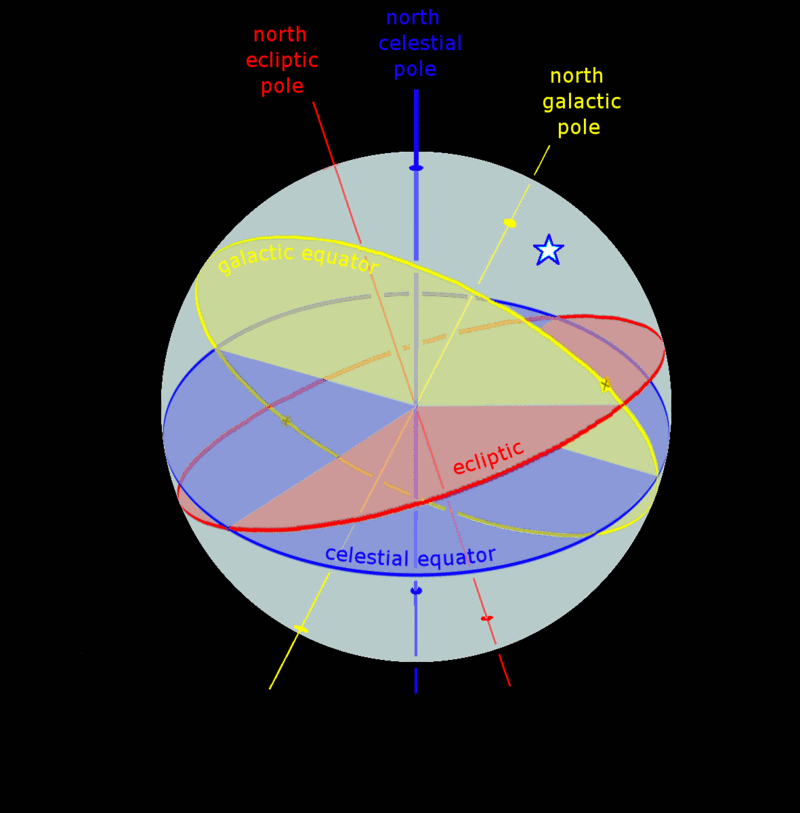

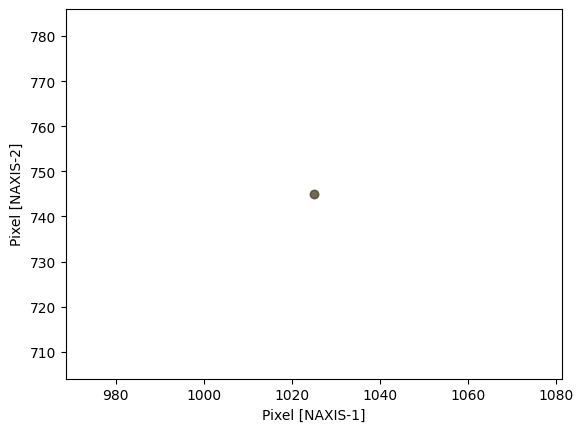

In [14]:
u_pix=[u_band[0].header['CRPIX1'],u_band[0].header['CRPIX2']]
g_pix=[g_band[0].header['CRPIX1'],g_band[0].header['CRPIX2']]
r_pix=[r_band[0].header['CRPIX1'],r_band[0].header['CRPIX2']]

plt.scatter(u_pix[0],u_pix[1],color='blue',edgecolors='blue',alpha=0.4)
plt.scatter(r_pix[0],r_pix[1],color='red',edgecolors='red',alpha=0.4)
plt.scatter(g_pix[0],g_pix[1],color='green',edgecolors='green',alpha=0.4)
plt.xlabel("Pixel [NAXIS-1]")
plt.ylabel("Pixel [NAXIS-2]")
plt.show()

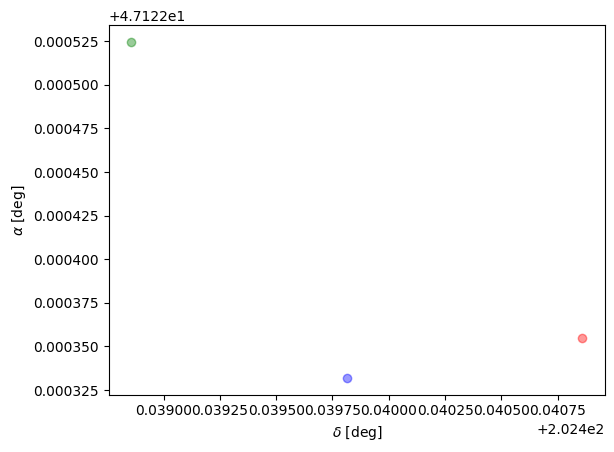

In [15]:
u_val=[u_band[0].header['CRVAL1'],u_band[0].header['CRVAL2']]
g_val=[g_band[0].header['CRVAL1'],g_band[0].header['CRVAL2']]
r_val=[r_band[0].header['CRVAL1'],r_band[0].header['CRVAL2']]

plt.scatter(u_val[0],u_val[1],color='blue',edgecolors='blue',alpha=0.4)
plt.scatter(r_val[0],r_val[1],color='red',edgecolors='red',alpha=0.4)
plt.scatter(g_val[0],g_val[1],color='green',edgecolors='green',alpha=0.4)
plt.xlabel(r"$\delta$ [deg]")
plt.ylabel(r"$\alpha$ [deg]")
plt.show()

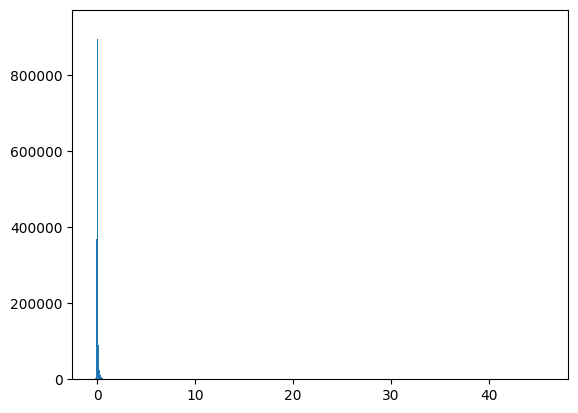

In [16]:
plt.hist(u_band[0].data.flat,bins=1000)
plt.show()

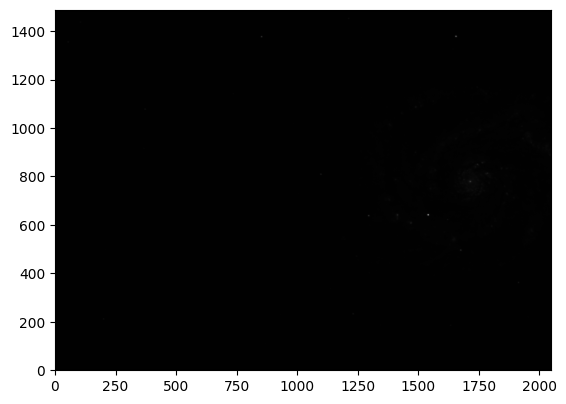

In [17]:
plt.imshow(u_band[0].data,origin='lower',cmap='gray')

Why is the image all black?

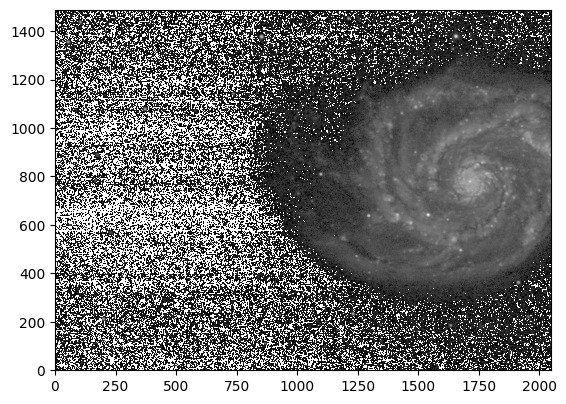

In [18]:
from matplotlib.colors import LogNorm
plt.imshow(u_band[0].data,origin='lower',cmap='gray',norm=LogNorm())
plt.show()

Why did we loose some of the data? (region where we have white spots)

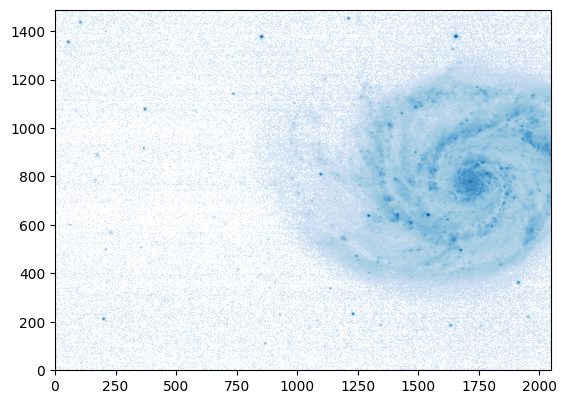

In [19]:
plt.imshow(u_band[0].data,origin='lower',cmap='Blues',norm=LogNorm())
plt.show()

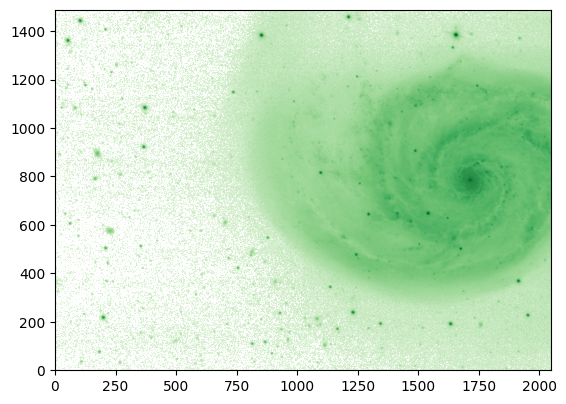

In [20]:
plt.imshow(g_band[0].data,origin='lower',cmap='Greens',norm=LogNorm())
plt.show()

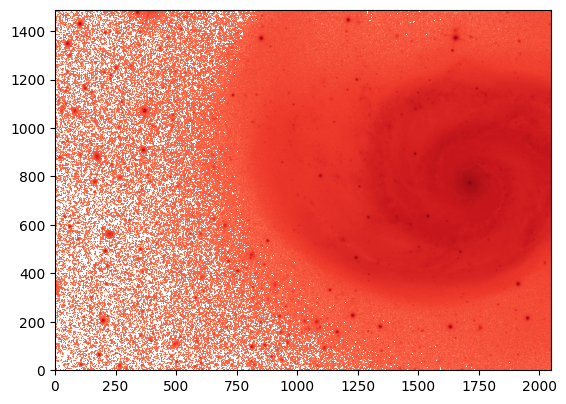

In [21]:
plt.imshow(r_band[0].data,origin='lower',cmap='Reds',norm=LogNorm())
plt.show()

Using `plt.imshow()` to display the image removes lot of imformation, because of the negative pixel values.

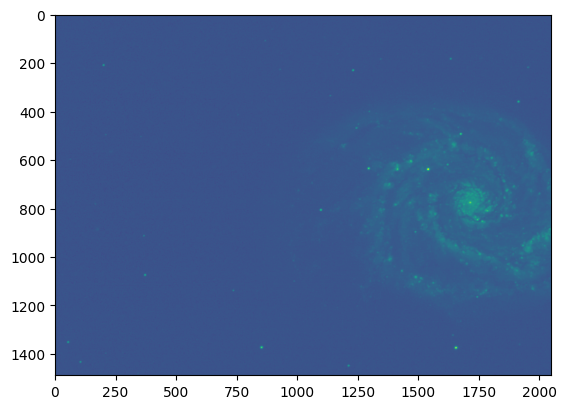

In [22]:
from astropy.visualization import (imshow_norm,MinMaxInterval,LogStretch,make_lupton_rgb)

imshow_norm(u_band[0].data,interval=MinMaxInterval(),stretch=LogStretch())
plt.show()

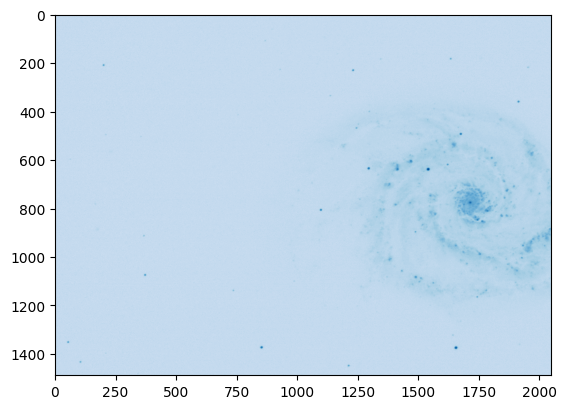

In [23]:
imshow_norm(u_band[0].data,interval=MinMaxInterval(),stretch=LogStretch(),cmap='Blues')
plt.show()

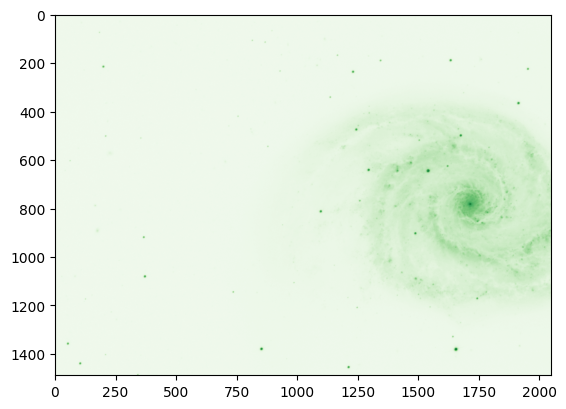

In [24]:
imshow_norm(g_band[0].data,interval=MinMaxInterval(),stretch=LogStretch(),cmap='Greens')
plt.show()

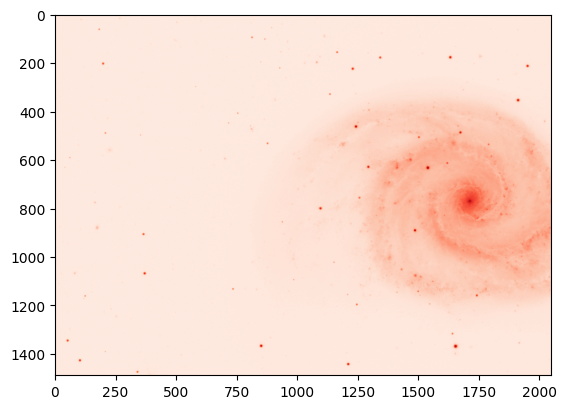

In [25]:
imshow_norm(r_band[0].data,interval=MinMaxInterval(),stretch=LogStretch(),cmap='Reds')
plt.show()

(<matplotlib.image.AxesImage at 0x7efdf3fb7110>,
 <astropy.visualization.mpl_normalize.ImageNormalize at 0x7efdcc215550>)

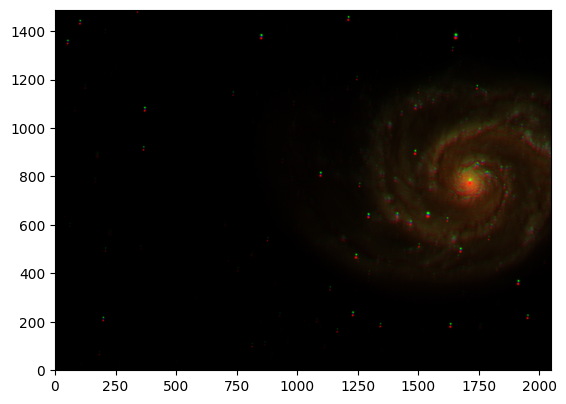

In [26]:
rgb_image=make_lupton_rgb(r_band[0].data,g_band[0].data,u_band[0].data)

imshow_norm(rgb_image,origin='lower')

(<matplotlib.image.AxesImage at 0x7efdf17cf110>,
 <astropy.visualization.mpl_normalize.ImageNormalize at 0x7efdf3d303d0>)

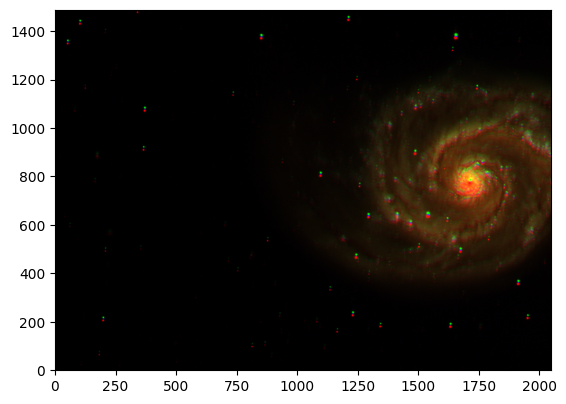

In [27]:
rgb_image=make_lupton_rgb(r_band[0].data,g_band[0].data,u_band[0].data,Q=4, stretch=3)

imshow_norm(rgb_image,origin='lower')